Meant to be run in google collab

In [ ]:
!pip install -q torch torchvision matplotlib

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import os
from tqdm import tqdm
import numpy as np

In [ ]:
class DoubleConv(nn.Module):
    def __init__(self, in_c, out_c):
        super().__init__()
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_c, out_c, 3, padding=1),
            nn.BatchNorm2d(out_c),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_c, out_c, 3, padding=1),
            nn.BatchNorm2d(out_c),
            nn.ReLU(inplace=True),
        )

    def forward(self, x):
        return self.double_conv(x)

def center_crop(tensor, target_tensor):
    _, _, h, w = tensor.size()
    _, _, th, tw = target_tensor.size()
    dh = (h - th) // 2
    dw = (w - tw) // 2
    return tensor[:, :, dh:dh+th, dw:dw+tw]

class UNet(nn.Module):
    def __init__(self, n_classes):
        super().__init__()
        self.down1 = DoubleConv(1, 32)
        self.down2 = DoubleConv(32, 64)
        self.down3 = DoubleConv(64, 128)
        self.down4 = DoubleConv(128, 256)
        self.mid = DoubleConv(256, 512)

        self.up4 = nn.ConvTranspose2d(512, 256, 2, stride=2)
        self.conv4 = DoubleConv(512, 256)
        self.up3 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.conv3 = DoubleConv(256, 128)
        self.up2 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.conv2 = DoubleConv(128, 64)
        self.up1 = nn.ConvTranspose2d(64, 32, 2, stride=2)
        self.conv1 = DoubleConv(64, 32)

        self.final = nn.Conv2d(32, n_classes, kernel_size=1)

    def forward(self, x):
        d1 = self.down1(x)
        d2 = self.down2(F.max_pool2d(d1, 2))
        d3 = self.down3(F.max_pool2d(d2, 2))
        d4 = self.down4(F.max_pool2d(d3, 2))
        mid = self.mid(F.max_pool2d(d4, 2))

        u4 = self.up4(mid)
        d4 = center_crop(d4, u4)
        u4 = self.conv4(torch.cat([u4, d4], dim=1))

        u3 = self.up3(u4)
        d3 = center_crop(d3, u3)
        u3 = self.conv3(torch.cat([u3, d3], dim=1))

        u2 = self.up2(u3)
        d2 = center_crop(d2, u2)
        u2 = self.conv2(torch.cat([u2, d2], dim=1))

        u1 = self.up1(u2)
        d1 = center_crop(d1, u1)
        u1 = self.conv1(torch.cat([u1, d1], dim=1))

        return self.final(u1)

In [ ]:
def load_16bit_image(image_path):
    image = Image.open(image_path)  # mode is 'I;16'
    np_image = np.array(image).astype(np.float32)

    # Normalize to [0, 1] using max possible 16-bit value
    np_image /= 65535.0

    # Add channel dimension and convert to tensor
    tensor = torch.from_numpy(np_image).unsqueeze(0)  # shape: (1, H, W)
    return tensor

class GrayscaleSegmentationDataset(Dataset):
    def __init__(self, image_dir, mask_dir, patch_shape=(656, 656)):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.image_files = sorted(os.listdir(image_dir))
        self.mask_files = sorted(os.listdir(mask_dir))
        self.patch_shape = patch_shape

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        image_path = os.path.join(self.image_dir, self.image_files[idx])
        mask_path = os.path.join(self.mask_dir, self.mask_files[idx])

        # Load 16-bit image without conversion
        image_tensor = load_16bit_image(image_path)

        # Load and resize mask
        mask = Image.open(mask_path).convert("L")
        mask = mask.resize(self.patch_shape[::-1], resample=Image.NEAREST)
        mask_tensor = transforms.PILToTensor()(mask).squeeze(0).long()

        # Convert all non-zero values to 1
        mask_tensor = (mask_tensor > 0).long()

        return image_tensor, mask_tensor

In [ ]:
def train_model(image_dir, mask_dir, num_classes=2, num_epochs=25):
    dataset = GrayscaleSegmentationDataset(image_dir, mask_dir)
    dataloader = DataLoader(dataset, batch_size=1, shuffle=True)

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = UNet(n_classes=num_classes).to(device)

    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)

    for epoch in range(num_epochs):
        model.train()
        total_loss = 0

        for images, masks in tqdm(dataloader):
            images, masks = images.to(device), masks.to(device)

            outputs = model(images)
            loss = criterion(outputs, masks)

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            total_loss += loss.item()

        print(f"Epoch {epoch+1}/{num_epochs}, Loss: {total_loss/len(dataloader):.4f}")

    torch.save(model.state_dict(), "unet_light_colab.pth")
    print("✅ Training complete. Model saved.")

In [ ]:
# ▶️ Run training
image_dir = "/content/drive/MyDrive/segmentation_data/train/images"
mask_dir = "/content/drive/MyDrive/segmentation_data/train/masks"
train_model(image_dir, mask_dir, num_classes=2, num_epochs=25)

100%|██████████| 442/442 [08:22<00:00,  1.14s/it]


Epoch 1/25, Loss: 0.1820


100%|██████████| 442/442 [00:19<00:00, 22.85it/s]


Epoch 2/25, Loss: 0.0832


100%|██████████| 442/442 [00:19<00:00, 22.87it/s]


Epoch 3/25, Loss: 0.0517


100%|██████████| 442/442 [00:19<00:00, 22.89it/s]


Epoch 4/25, Loss: 0.0388


100%|██████████| 442/442 [00:19<00:00, 22.79it/s]


Epoch 5/25, Loss: 0.0315


100%|██████████| 442/442 [00:19<00:00, 22.85it/s]


Epoch 6/25, Loss: 0.0264


100%|██████████| 442/442 [00:19<00:00, 22.97it/s]


Epoch 7/25, Loss: 0.0250


100%|██████████| 442/442 [00:19<00:00, 22.84it/s]


Epoch 8/25, Loss: 0.0222


100%|██████████| 442/442 [00:19<00:00, 22.64it/s]


Epoch 9/25, Loss: 0.0209


100%|██████████| 442/442 [00:19<00:00, 22.72it/s]


Epoch 10/25, Loss: 0.0201


100%|██████████| 442/442 [00:19<00:00, 22.86it/s]


Epoch 11/25, Loss: 0.0194


100%|██████████| 442/442 [00:19<00:00, 22.77it/s]


Epoch 12/25, Loss: 0.0188


100%|██████████| 442/442 [00:19<00:00, 22.95it/s]


Epoch 13/25, Loss: 0.0185


100%|██████████| 442/442 [00:19<00:00, 22.60it/s]


Epoch 14/25, Loss: 0.0176


100%|██████████| 442/442 [00:19<00:00, 22.68it/s]


Epoch 15/25, Loss: 0.0170


100%|██████████| 442/442 [00:19<00:00, 22.77it/s]


Epoch 16/25, Loss: 0.0174


100%|██████████| 442/442 [00:19<00:00, 22.79it/s]


Epoch 17/25, Loss: 0.0168


100%|██████████| 442/442 [00:19<00:00, 22.86it/s]


Epoch 18/25, Loss: 0.0164


100%|██████████| 442/442 [00:19<00:00, 22.80it/s]


Epoch 19/25, Loss: 0.0159


100%|██████████| 442/442 [00:19<00:00, 22.58it/s]


Epoch 20/25, Loss: 0.0157


100%|██████████| 442/442 [00:19<00:00, 22.60it/s]


Epoch 21/25, Loss: 0.0151


100%|██████████| 442/442 [00:19<00:00, 22.51it/s]


Epoch 22/25, Loss: 0.0147


100%|██████████| 442/442 [00:19<00:00, 22.66it/s]


Epoch 23/25, Loss: 0.0144


100%|██████████| 442/442 [00:19<00:00, 22.67it/s]


Epoch 24/25, Loss: 0.0140


100%|██████████| 442/442 [00:19<00:00, 22.71it/s]


Epoch 25/25, Loss: 0.0149
✅ Training complete. Model saved.


In [ ]:
# Load model for prediction
model = UNet(n_classes=2)
model.load_state_dict(torch.load("unet_light_colab.pth", map_location=torch.device('cuda' if torch.cuda.is_available() else 'cpu')))
model.eval()

UNet(
  (down1): DoubleConv(
    (double_conv): Sequential(
      (0): Conv2d(1, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace=True)
    )
  )
  (down2): DoubleConv(
    (double_conv): Sequential(
      (0): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace=True)
    )
  )
  (down3): DoubleConv(
    (double_conv): Sequential(
      (0): Conv2d(64,

In [ ]:
import matplotlib.pyplot as plt



def predict_and_show_folder(image_folder, model, patch_shape=(656, 656), max_images=100):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = model.to(device)
    model.eval()

    image_files = sorted([
        f for f in os.listdir(image_folder)
        if f.lower().endswith(('.png', '.jpg', '.jpeg', '.tif', '.tiff'))
    ])

    for i, filename in enumerate(image_files[:max_images]):
        image_path = os.path.join(image_folder, filename)

        # Load and preprocess 16-bit image
        image_tensor = load_16bit_image(image_path)
        input_tensor = image_tensor.unsqueeze(0).to(device)  # shape: (1, 1, H, W)

        # Predict
        with torch.no_grad():
            output = model(input_tensor)
            pred = torch.argmax(output, dim=1).squeeze().cpu().numpy()

        # Convert normalized image to 2D for plotting
        image_np = image_tensor.squeeze(0).numpy()  # shape: (H, W)

        # Show original + prediction
        fig, ax = plt.subplots(1, 2, figsize=(10, 5))
        ax[0].imshow(image_np, cmap="gray", vmin=0, vmax=1)
        ax[0].set_title(f"Normalized Original: {filename}")
        ax[0].axis("off")

        ax[1].imshow(pred, cmap="jet")
        ax[1].set_title("Predicted Segmentation")
        ax[1].axis("off")

        plt.tight_layout()
        plt.show()

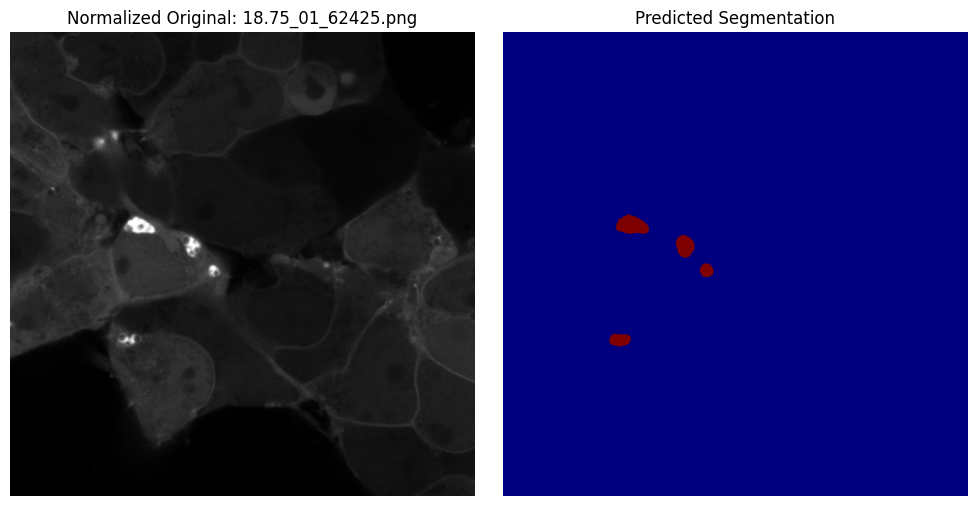

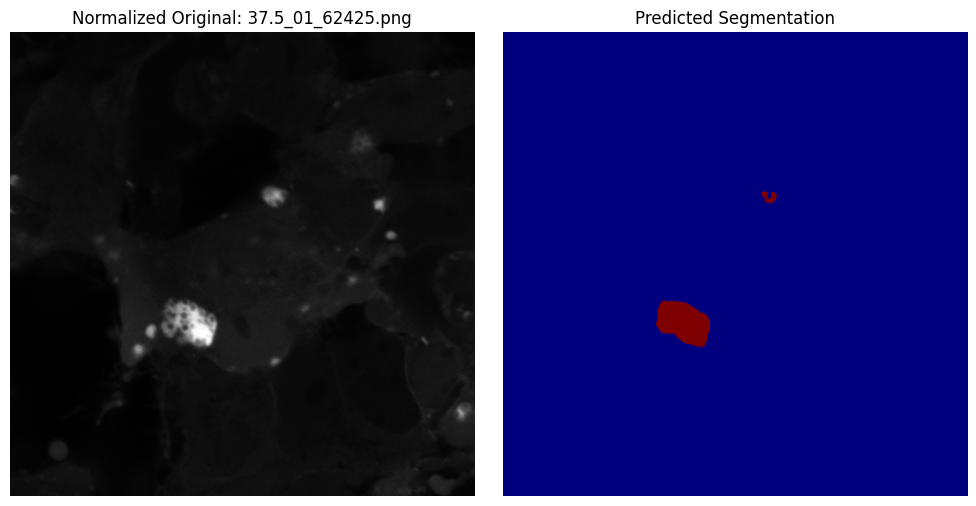

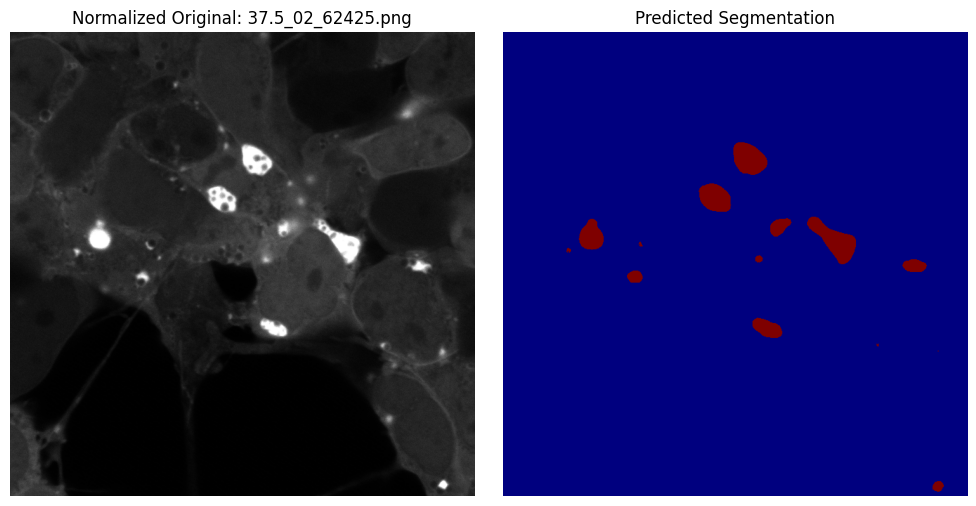

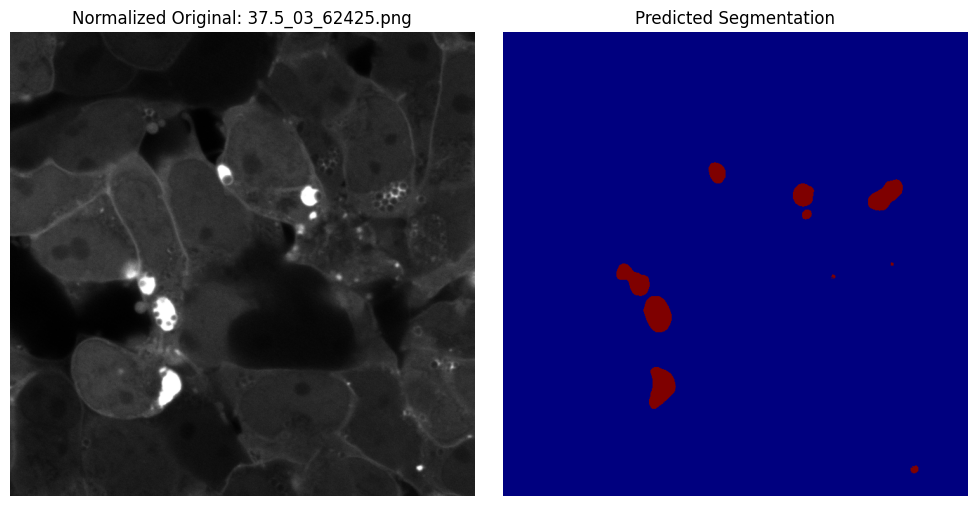

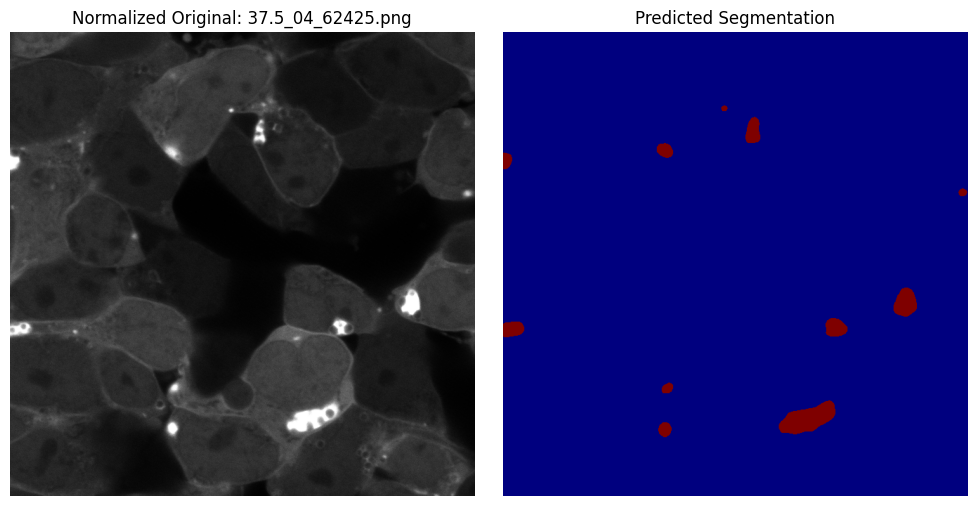

...

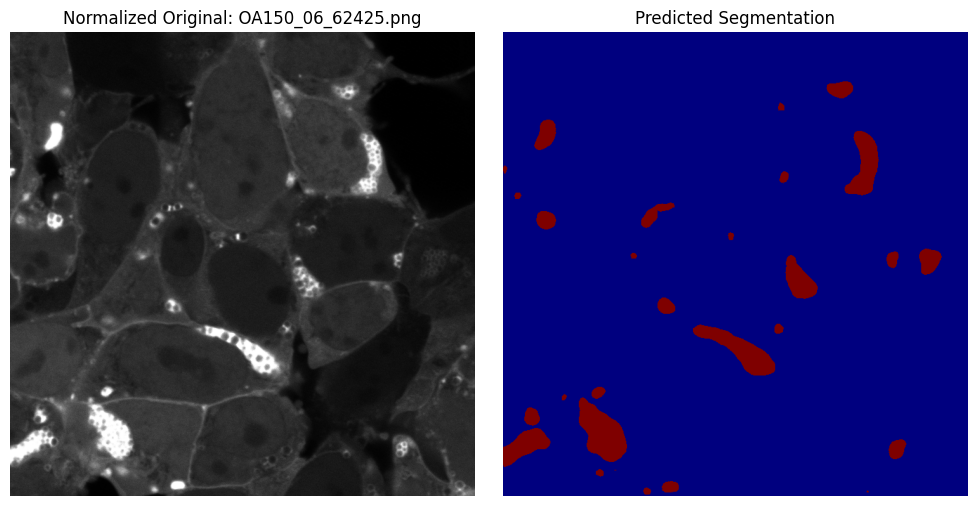

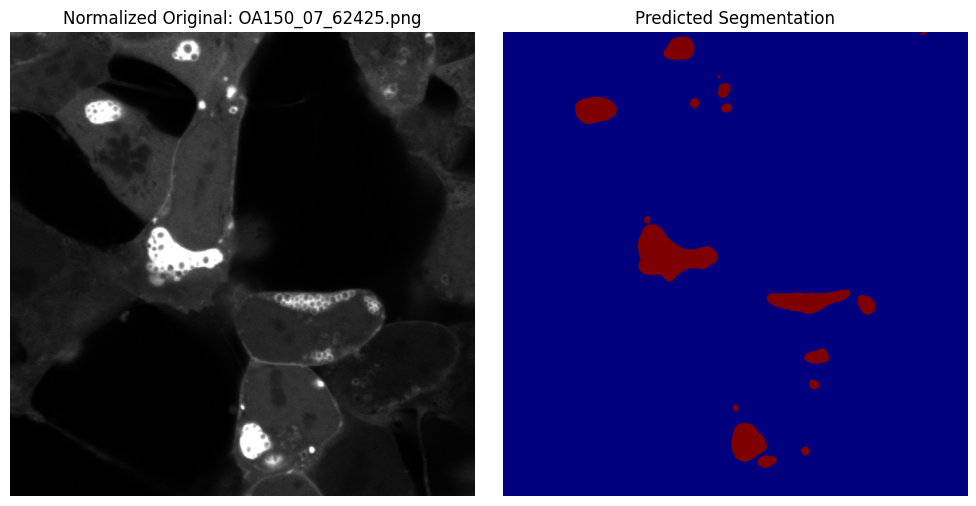

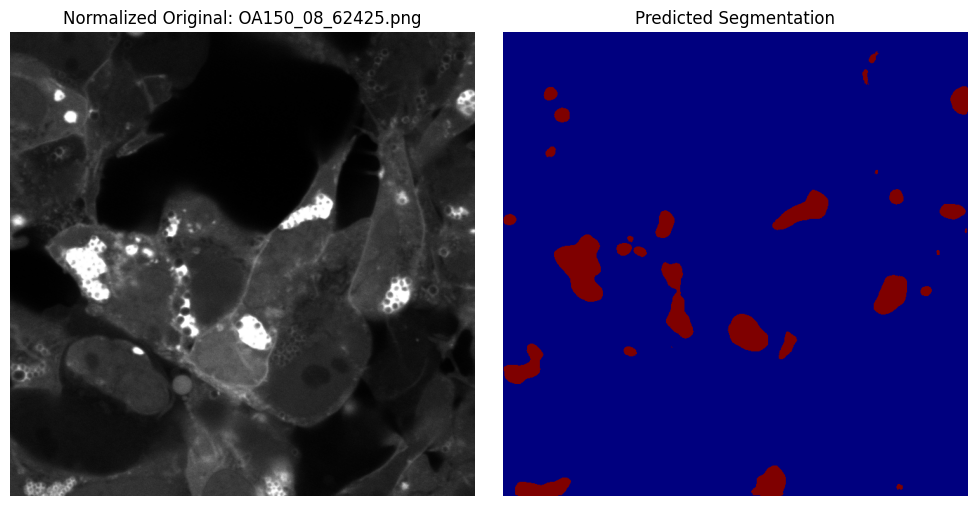

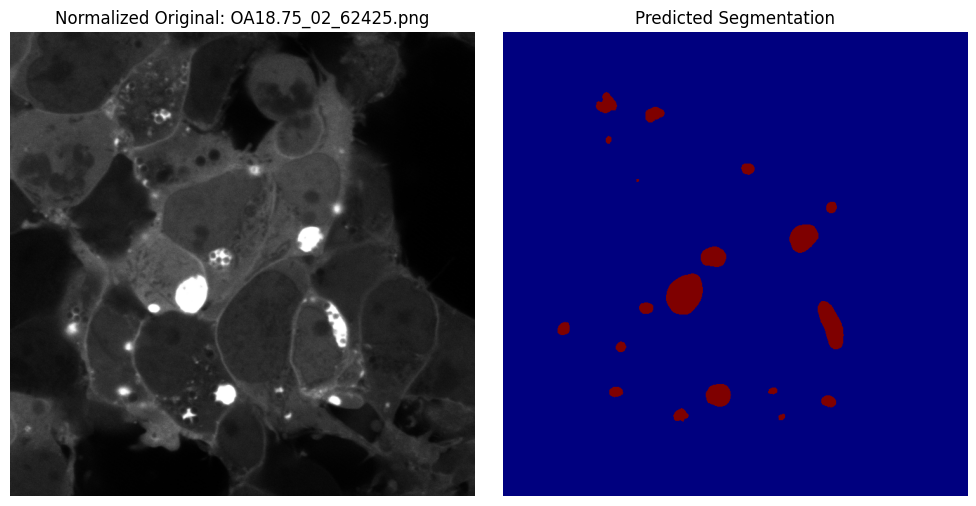

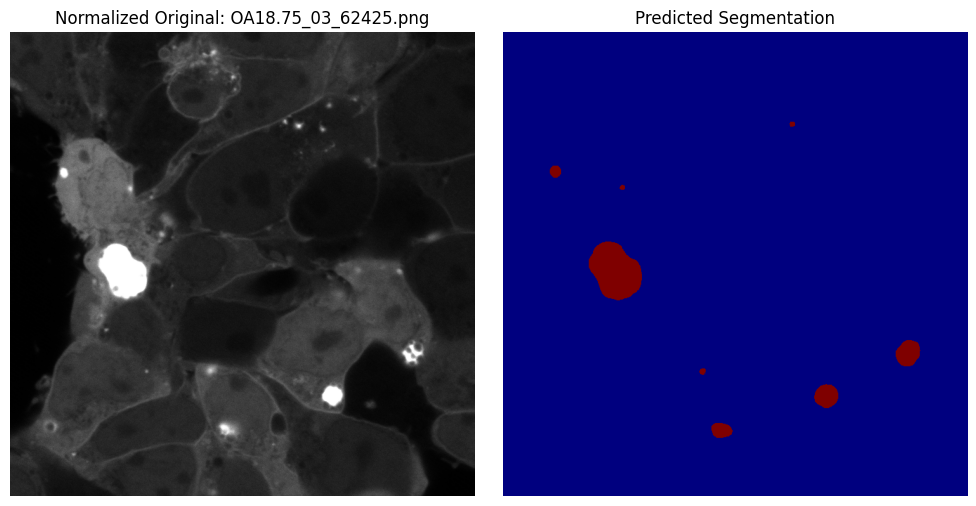

In [ ]:
predict_and_show_folder("/content/drive/MyDrive/test_set/images", model)